In [144]:
#fig = px.box(df_new, x = 'Alcoholism', y = 'prior_appointments', color='No-show')
#fig.show()

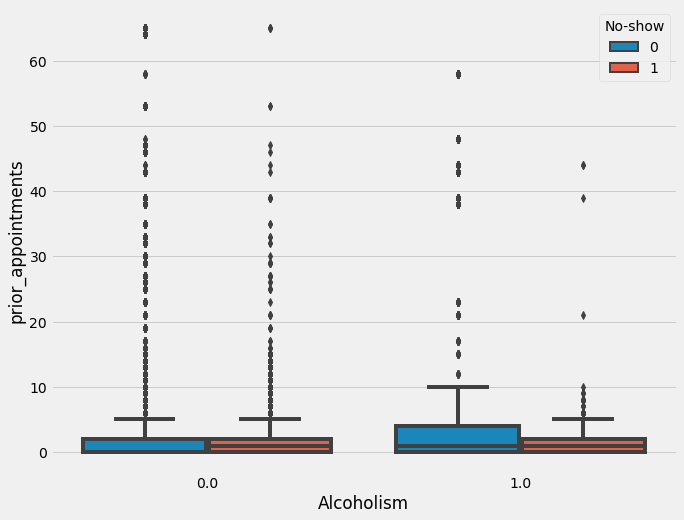

In [145]:
plt.rcParams['figure.figsize'] = (10,8)

sns.boxplot(x=df_new['Alcoholism'], y=df_new['prior_appointments'], hue=df_new['No-show'])
plt.show()

In [146]:
#fig = px.box(df_new, x = 'Handcap', y = 'prior_appointments', color='No-show')
#fig.show()

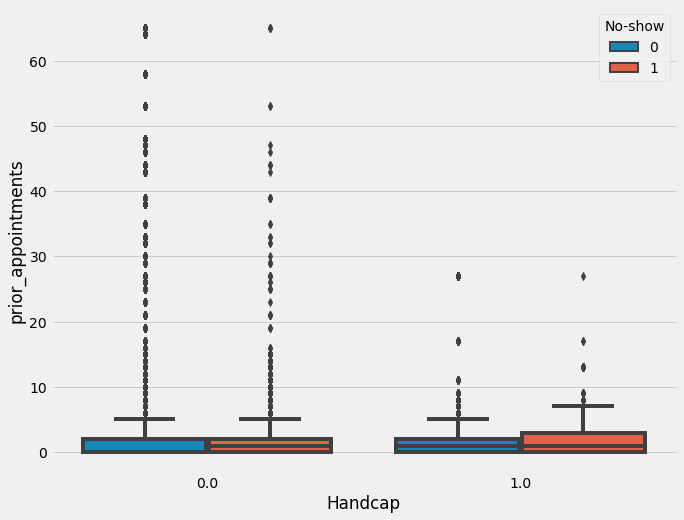

In [147]:
plt.rcParams['figure.figsize'] = (10,8)

sns.boxplot(x=df_new['Handcap'], y=df_new['prior_appointments'], hue=df_new['No-show'])
plt.show()

In [148]:
#fig = px.box(df_new, x = 'Hipertension', y = 'prior_appointments', color='No-show')
#fig.show()

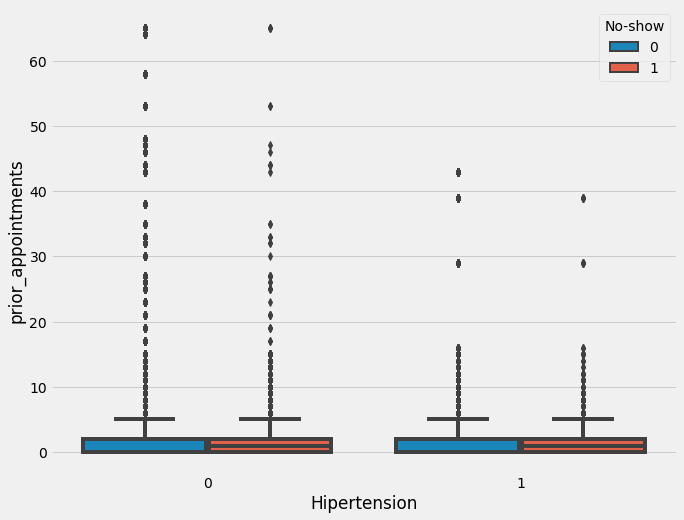

In [149]:
plt.rcParams['figure.figsize'] = (10,8)

sns.boxplot(x=df_new['Hipertension'], y=df_new['prior_appointments'], hue=df_new['No-show'])
plt.show()

In [150]:
#fig = px.box(df_new, x = 'Scholarship', y = 'prior_appointments', color='No-show')
#fig.show()

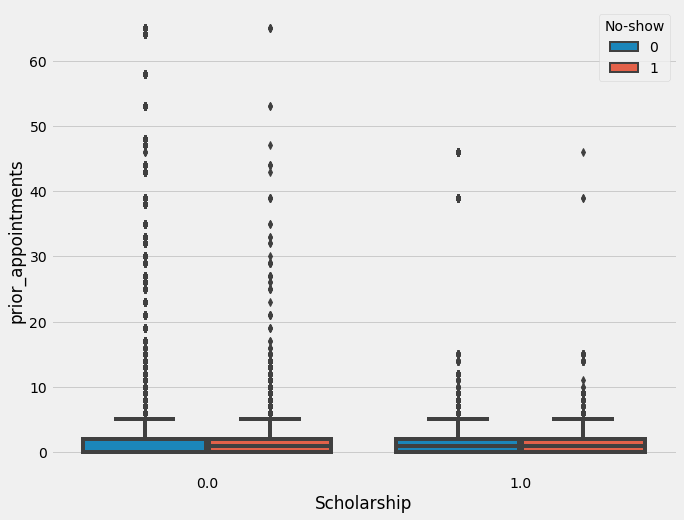

In [151]:
plt.rcParams['figure.figsize'] = (10,8)

sns.boxplot(x=df_new['Scholarship'], y=df_new['prior_appointments'], hue=df_new['No-show'])
plt.show()

In [152]:
fig = px.box(df_new, x = 'SMS_received', y = 'prior_appointments', color='No-show')
fig.show()

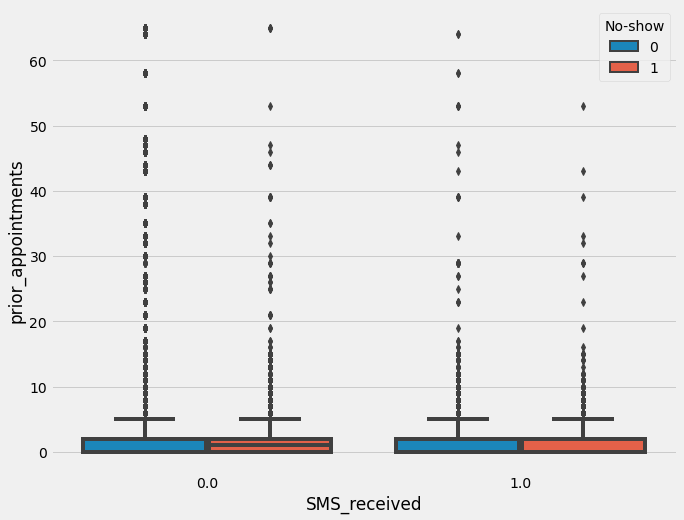

In [153]:
plt.rcParams['figure.figsize'] = (10,8)
sns.boxplot(x=df_new['SMS_received'], y=df_new['prior_appointments'], hue=df_new['No-show'])
plt.show()

In [154]:
fig = px.box(df_new, x = df_sorted2, y = 'prior_appointments', color='No-show')
fig.show()

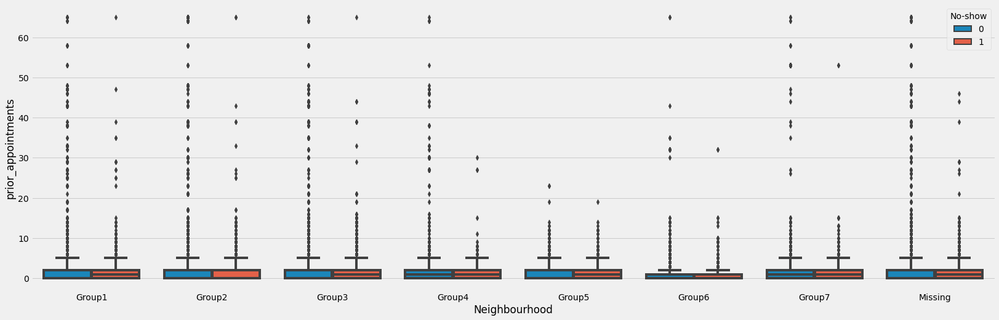

In [155]:
plt.rcParams['figure.figsize'] = (25,8)
sns.boxplot(x=df_sorted2, y=df_new['prior_appointments'], hue=df_new['No-show'])
plt.show()

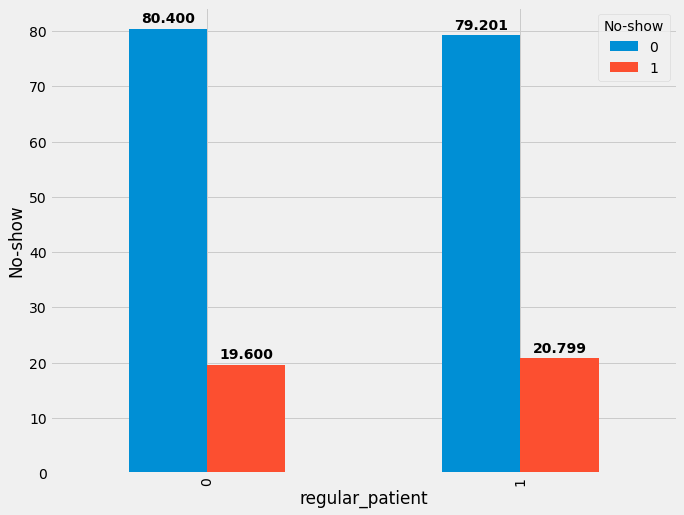

In [156]:
plt.rcParams['figure.figsize'] = (10,8)
p1 = (pd.crosstab(df_new['regular_patient'], df_new['No-show'], normalize='index')*100).plot.bar()
for p in p1.patches:
  p1.annotate(f'{p.get_height():0.3f}', (p.get_x() + p.get_width() / 2., p.get_height()), ha = 'center', va = 'center', 
                      xytext = (0, 10), textcoords = 'offset points', weight = 'bold')
plt.ylabel('No-show')
plt.show()

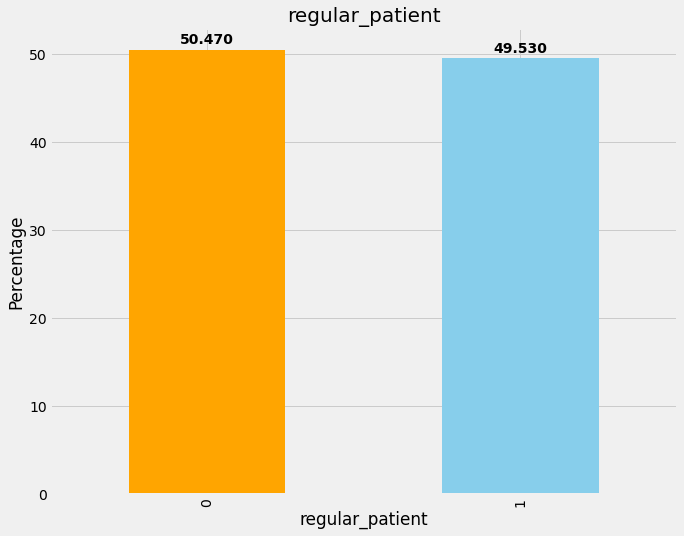

In [157]:
plot_value_counts(df_new, 'regular_patient')

In [158]:
#fig = px.box(df_new, x = 'Gender', y = 'Waitingperiod', color='No-show')
#fig.show()

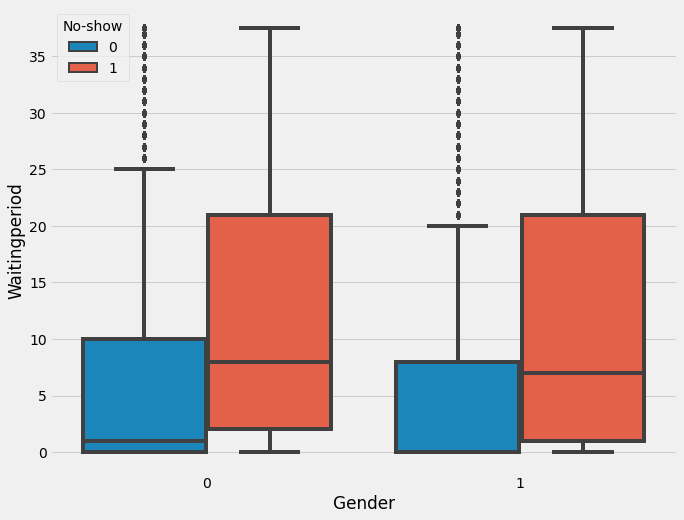

In [159]:
sns.boxplot(x=df_new['Gender'], y=df_new['Waitingperiod'], hue=df_new['No-show'])
plt.show()

From the above boxplot we see that for the female patients who show up for the appointments the wating period is very low, on the other hand for male patients who show up for the appointments the wating period is even lower where the median value is close to zero. For patients who donnot show up for the appointments the waiting period is almost the same for both female and male.

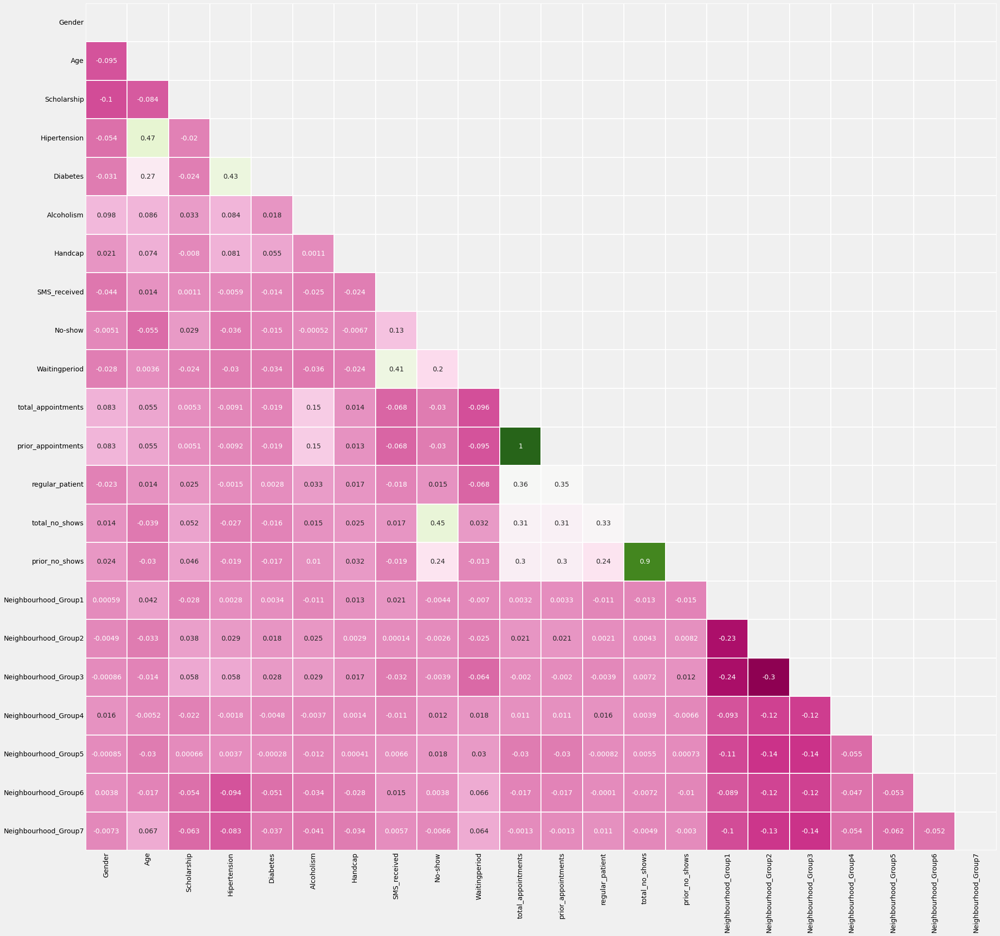

In [160]:
plt.figure(figsize=(30,30))
correlation= df_new.corr()
matrix = np.triu(correlation)
sns.heatmap(correlation, annot=True, linecolor="white",linewidths=0.02,mask=matrix,cbar=False,cmap="PiYG")
plt.show()

In [161]:
df_new = df_new.drop(['total_no_shows','total_appointments'], axis = 1)

Since we see that total no show and prior no show, also total appointment and prior appointments are highly correlated we drop total no show and total appointments.

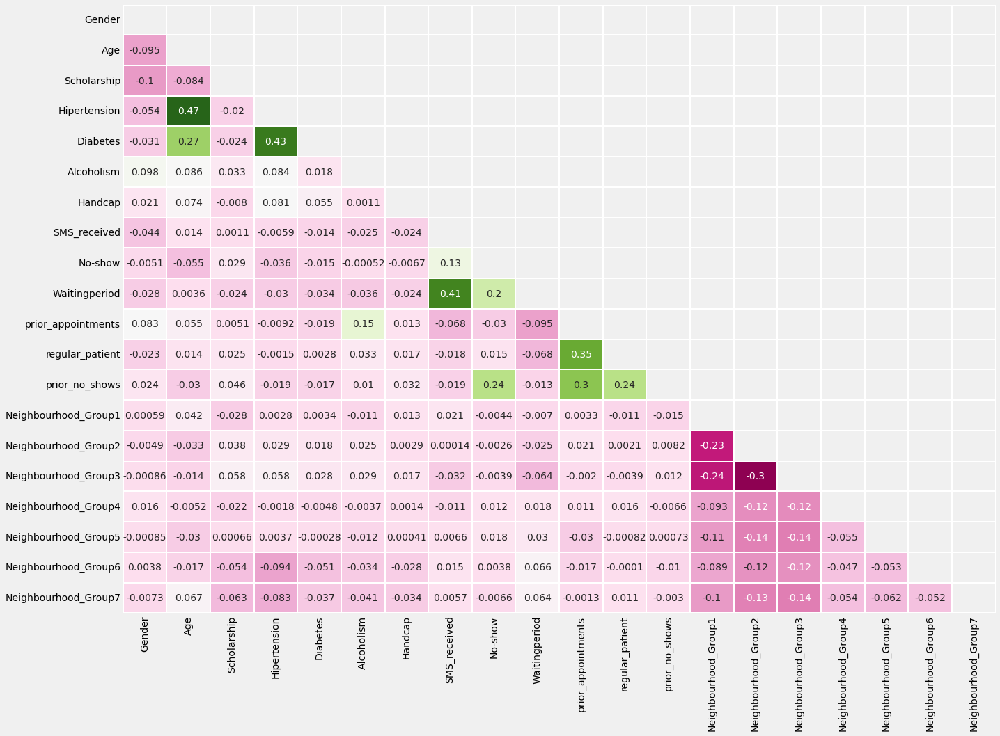

In [162]:
plt.figure(figsize=(20, 15))
correlation= df_new.corr()
matrix = np.triu(correlation)
sns.heatmap(correlation, annot=True, linecolor="white",linewidths=0.02,mask=matrix,cbar=False,cmap="PiYG")
plt.show()

In [163]:
df_new.columns

Index(['Gender', 'Age', 'Scholarship', 'Hipertension', 'Diabetes',
       'Alcoholism', 'Handcap', 'SMS_received', 'No-show', 'Waitingperiod',
       'prior_appointments', 'regular_patient', 'prior_no_shows',
       'Neighbourhood_Group1', 'Neighbourhood_Group2', 'Neighbourhood_Group3',
       'Neighbourhood_Group4', 'Neighbourhood_Group5', 'Neighbourhood_Group6',
       'Neighbourhood_Group7'],
      dtype='object')

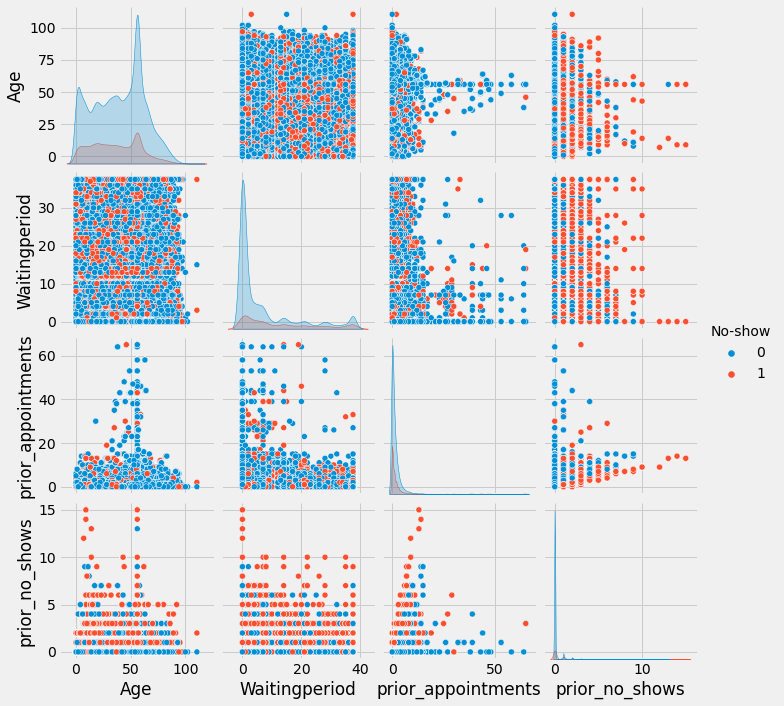

In [164]:
sns.pairplot(df_new[['Age', 'Waitingperiod', 'prior_appointments', 'prior_no_shows', 'No-show']], diag_kind='kde',hue='No-show')
plt.show()

## Statistical Test

In [165]:
from scipy import stats

In [166]:
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['No-show'], df_new[i]))[1]
          p_val.append(pval)

Chi square test to check the relationship between all the Categorical explanatory Variables with respect to Target Variable.

H0 : There is no relationship between Explanatory Variable and the Target Variable

H1 : There is a relationship between Explanatory Variable and the Target Variable

In [167]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.090886
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.879710
5,Handcap,0.027301
6,SMS_received,0.000000
7,prior_appointments,0.000000
8,regular_patient,0.000001
9,prior_no_shows,0.000000


Here we see that Alcoholism, Handcap, Neighbourhood_Group1,Neighbourhood_Group2,Neighbourhood_Group3,Neighbourhood_Group6 are having no relationship with the target variable.



In [168]:
show = df_new[df_new['No-show']==0]
no_show = df_new[df_new['No-show']==1]

Anova test to check whether there is a relationship between group means based on Target Variable.

H0 : There is no relationship between group means

H1 : There is a relationship between group means

In [169]:
p_val=[]
for i in ['Age','Waitingperiod']:
    pval = stats.f_oneway(show[i], no_show[i])[1]
    p_val.append(pval)

In [170]:
p_val_anova = pd.DataFrame({'Feature': ['Age','Waitingperiod'],
                          'p_values' : p_val})
p_val_anova[p_val_anova['p_values']<0.05]

,Feature,p_values
0,Age,0.000000
1,Waitingperiod,0.000000


Here we see that Age and Waitingperiod are having a relationship between group means based on the target variable.

Checking for multicollinearity within the explanatory categorical variables. using chisquare test

In [171]:
# Gender
p_val = []

for i in ['Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Gender'], df_new[i]))[1]
          p_val.append(pval)

In [172]:
p_val_cat = pd.DataFrame({'Feature': ['Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Scholarship,0.000000
1,Hipertension,0.000000
2,Diabetes,0.000000
3,Alcoholism,0.000000
4,Handcap,0.000000
5,SMS_received,0.000000
6,prior_appointments,0.000000
7,regular_patient,0.000000
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.852071


In [173]:
# Scholarship
p_val = []

for i in ['Gender','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Scholarship'], df_new[i]))[1]
          p_val.append(pval)

In [174]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Hipertension,0.000000
2,Diabetes,0.000000
3,Alcoholism,0.000000
4,Handcap,0.008966
5,SMS_received,0.724554
6,prior_appointments,0.000000
7,regular_patient,0.000000
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.000000


In [175]:
# Hypertension
p_val = []

for i in ['Gender','Scholarship','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Hipertension'], df_new[i]))[1]
          p_val.append(pval)

In [176]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.000000
2,Diabetes,0.000000
3,Alcoholism,0.000000
4,Handcap,0.000000
5,SMS_received,0.051806
6,prior_appointments,0.000000
7,regular_patient,0.613155
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.357011


In [177]:
# Diabetes
p_val = []

for i in ['Gender','Scholarship','Hipertension','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Diabetes'], df_new[i]))[1]
          p_val.append(pval)

In [178]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Alcoholism,0.000000
4,Handcap,0.000000
5,SMS_received,0.000006
6,prior_appointments,0.000000
7,regular_patient,0.365246
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.263466


In [179]:
# Alcoholism
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Alcoholism'], df_new[i]))[1]
          p_val.append(pval)

In [180]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Handcap','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Handcap,0.771186
5,SMS_received,0.000000
6,prior_appointments,0.000000
7,regular_patient,0.000000
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.000407


In [181]:
# Handcap
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Handcap'], df_new[i]))[1]
          p_val.append(pval)

In [182]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','SMS_received','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.008966
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.771186
5,SMS_received,0.000000
6,prior_appointments,0.000000
7,regular_patient,0.000000
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.000025


In [183]:
# SMS received
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['SMS_received'], df_new[i]))[1]
          p_val.append(pval)

In [184]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','prior_appointments','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.724554
2,Hipertension,0.051806
3,Diabetes,0.000006
4,Alcoholism,0.000000
5,Handcap,0.000000
6,prior_appointments,0.000000
7,regular_patient,0.000000
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.000000


In [185]:
# prior apointments
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['prior_appointments'], df_new[i]))[1]
          p_val.append(pval)

In [186]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','regular_patient','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.000000
5,Handcap,0.000000
6,SMS_received,0.000000
7,regular_patient,0.000000
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.000000


In [187]:
# regular patients
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['regular_patient'], df_new[i]))[1]
          p_val.append(pval)

In [188]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','prior_no_shows',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.000000
2,Hipertension,0.613155
3,Diabetes,0.365246
4,Alcoholism,0.000000
5,Handcap,0.000000
6,SMS_received,0.000000
7,prior_appointments,0.000000
8,prior_no_shows,0.000000
9,Neighbourhood_Group1,0.000438


In [189]:
# prior_No_shows
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['prior_no_shows'], df_new[i]))[1]
          p_val.append(pval)

In [190]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments','regular_patient',
          'Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7'],
          'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.000000
5,Handcap,0.000000
6,SMS_received,0.000000
7,prior_appointments,0.000000
8,regular_patient,0.000000
9,Neighbourhood_Group1,0.000000


In [191]:
# Neighborhood_Group1
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments',
          'regular_patient','prior_no_shows','Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4',
          'Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Neighbourhood_Group1'], df_new[i]))[1]
          p_val.append(pval)

In [192]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received',
                                      'prior_appointments','regular_patient','prior_no_shows','Neighbourhood_Group2',
                                      'Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5',
                                      'Neighbourhood_Group6','Neighbourhood_Group7'],'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.852071
1,Scholarship,0.000000
2,Hipertension,0.357011
3,Diabetes,0.263466
4,Alcoholism,0.000407
5,Handcap,0.000025
6,SMS_received,0.000000
7,prior_appointments,0.000000
8,regular_patient,0.000438
9,prior_no_shows,0.000000


In [193]:
# Neighborhood_Group2
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments',
          'regular_patient','prior_no_shows','Neighbourhood_Group1','Neighbourhood_Group3','Neighbourhood_Group4',
          'Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Neighbourhood_Group2'], df_new[i]))[1]
          p_val.append(pval)

In [194]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received',
                                      'prior_appointments','regular_patient','prior_no_shows','Neighbourhood_Group1',
                                      'Neighbourhood_Group3','Neighbourhood_Group4','Neighbourhood_Group5',
                                      'Neighbourhood_Group6','Neighbourhood_Group7'],'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.106582
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.000000
5,Handcap,0.346247
6,SMS_received,0.968691
7,prior_appointments,0.000000
8,regular_patient,0.489895
9,prior_no_shows,0.000000


In [195]:
# Neighborhood_Group3
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments',
          'regular_patient','prior_no_shows','Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group4',
          'Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Neighbourhood_Group3'], df_new[i]))[1]
          p_val.append(pval)

In [196]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received',
                                      'prior_appointments','regular_patient','prior_no_shows','Neighbourhood_Group1',
                                      'Neighbourhood_Group2','Neighbourhood_Group4','Neighbourhood_Group5',
                                      'Neighbourhood_Group6','Neighbourhood_Group7'],'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.781491
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.000000
5,Handcap,0.000000
6,SMS_received,0.000000
7,prior_appointments,0.000000
8,regular_patient,0.199857
9,prior_no_shows,0.000000


In [197]:
# Neighborhood_Group4
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments',
          'regular_patient','prior_no_shows','Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3',
          'Neighbourhood_Group5','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Neighbourhood_Group4'], df_new[i]))[1]
          p_val.append(pval)

In [198]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received',
                                      'prior_appointments','regular_patient','prior_no_shows','Neighbourhood_Group1',
                                      'Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group5',
                                      'Neighbourhood_Group6','Neighbourhood_Group7'],'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.000000
1,Scholarship,0.000000
2,Hipertension,0.560086
3,Diabetes,0.116780
4,Alcoholism,0.241421
5,Handcap,0.668621
6,SMS_received,0.000331
7,prior_appointments,0.000000
8,regular_patient,0.000000
9,prior_no_shows,0.000001


In [199]:
# Neighborhood_Group5
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments',
          'regular_patient','prior_no_shows','Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3',
          'Neighbourhood_Group4','Neighbourhood_Group6','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Neighbourhood_Group5'], df_new[i]))[1]
          p_val.append(pval)

In [200]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received',
                                      'prior_appointments','regular_patient','prior_no_shows','Neighbourhood_Group1',
                                      'Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4',
                                      'Neighbourhood_Group6','Neighbourhood_Group7'],'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.787337
1,Scholarship,0.843272
2,Hipertension,0.223482
3,Diabetes,0.945602
4,Alcoholism,0.000105
5,Handcap,0.929056
6,SMS_received,0.028050
7,prior_appointments,0.000000
8,regular_patient,0.795598
9,prior_no_shows,0.000000


In [201]:
# Neighborhood_Group6
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments',
          'regular_patient','prior_no_shows','Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3',
          'Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group7']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Neighbourhood_Group6'], df_new[i]))[1]
          p_val.append(pval)

In [202]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received',
                                      'prior_appointments','regular_patient','prior_no_shows','Neighbourhood_Group1',
                                      'Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4',
                                      'Neighbourhood_Group5','Neighbourhood_Group7'],'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.211763
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.000000
5,Handcap,0.000000
6,SMS_received,0.000001
7,prior_appointments,0.000000
8,regular_patient,0.985135
9,prior_no_shows,0.000000


In [203]:
# Neighborhood_Group7
p_val = []

for i in ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received','prior_appointments',
          'regular_patient','prior_no_shows','Neighbourhood_Group1','Neighbourhood_Group2','Neighbourhood_Group3',
          'Neighbourhood_Group4','Neighbourhood_Group5','Neighbourhood_Group6']:
          pval = stats.chi2_contingency(pd.crosstab(df_new['Neighbourhood_Group7'], df_new[i]))[1]
          p_val.append(pval)

In [204]:
p_val_cat = pd.DataFrame({'Feature': ['Gender','Scholarship','Hipertension','Diabetes','Alcoholism','Handcap','SMS_received',
                                      'prior_appointments','regular_patient','prior_no_shows','Neighbourhood_Group1',
                                      'Neighbourhood_Group2','Neighbourhood_Group3','Neighbourhood_Group4',
                                      'Neighbourhood_Group5','Neighbourhood_Group6'],'p_values' : p_val})
p_val_cat

,Feature,p_values
0,Gender,0.015397
1,Scholarship,0.000000
2,Hipertension,0.000000
3,Diabetes,0.000000
4,Alcoholism,0.000000
5,Handcap,0.000000
6,SMS_received,0.061585
7,prior_appointments,0.000000
8,regular_patient,0.000409
9,prior_no_shows,0.000000


## Base Model

In [258]:
from sklearn.linear_model import LogisticRegression
import statsmodels.api as sm

X = df_new.drop(['No-show','Waitingperiod','prior_appointments','regular_patient','prior_no_shows'],axis = 1)

y = df_new['No-show']

Xc = sm.add_constant(X)

In [259]:
model = sm.Logit(y,Xc).fit()

print(model.summary())

Optimization terminated successfully.
         Current function value: 0.493229
         Iterations 6
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:               110524
Model:                          Logit   Df Residuals:                   110508
Method:                           MLE   Df Model:                           15
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                 0.01958
Time:                        15:08:40   Log-Likelihood:                -54514.
converged:                       True   LL-Null:                       -55602.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -1.4195      0.024    -58.464      0.000      -1.467      -1.372

In [260]:
from sklearn.metrics import confusion_matrix,accuracy_score, f1_score, classification_report, fbeta_score
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(Xc, y, random_state = 10, test_size = 0.3)

logreg = LogisticRegression(solver = 'liblinear')
logreg = logreg.fit(X_train,y_train)

y_pred_train = logreg.predict(X_train)
y_prob_train = logreg.predict_proba(X_train)[:,1]

y_pred_test = logreg.predict(X_test)
y_prob_test = logreg.predict_proba(X_test)[:,1]

print('Confusion Matrix-Train','\n' ,confusion_matrix(y_train,y_pred_train),'\n')
print('Classification Report -Train','\n' ,classification_report(y_train,y_pred_train))
print('Accuracy-Train', '\n' ,accuracy_score(y_train,y_pred_train),'\n')
print('ROC_AUC-Train', '\n' ,roc_auc_score(y_train,y_prob_train),'\n')

print('Confusion Matrix-Test', '\n' ,confusion_matrix(y_test,y_pred_test),'\n')
print('Classification Report -Test','\n' ,classification_report(y_test,y_pred_test))
print('Accuracy-Test', '\n' ,accuracy_score(y_test,y_pred_test),'\n')
print('ROC_AUC-Test','\n' , roc_auc_score(y_test,y_prob_test),'\n')

Confusion Matrix-Train 
 [[61709     0]
 [15657     0]] 

Classification Report -Train 
               precision    recall  f1-score   support

           0       0.80      1.00      0.89     61709
           1       0.00      0.00      0.00     15657

    accuracy                           0.80     77366
   macro avg       0.40      0.50      0.44     77366
weighted avg       0.64      0.80      0.71     77366

Accuracy-Train 
 0.7976242793992193 

ROC_AUC-Train 
 0.5952342418361867 

Confusion Matrix-Test 
 [[26496     0]
 [ 6662     0]] 

Classification Report -Test 
               precision    recall  f1-score   support

           0       0.80      1.00      0.89     26496
           1       0.00      0.00      0.00      6662

    accuracy                           0.80     33158
   macro avg       0.40      0.50      0.44     33158
weighted avg       0.64      0.80      0.71     33158

Accuracy-Test 
 0.7990831775137222 

ROC_AUC-Test 
 0.5957146961659393 



In [261]:
from sklearn.metrics import confusion_matrix,accuracy_score, f1_score, classification_report, fbeta_score
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(Xc, y, random_state = 10, test_size = 0.3)

logreg = LogisticRegression(solver = 'liblinear')
logreg = logreg.fit(X_train,y_train)

y_pred_train = logreg.predict(X_train)
y_prob_train = logreg.predict_proba(X_train)[:,1]

y_pred_test = logreg.predict(X_test)
y_prob_test = logreg.predict_proba(X_test)[:,1]

print('Confusion Matrix-Train','\n' ,confusion_matrix(y_train,y_pred_train),'\n')
print('Classification Report -Train','\n' ,classification_report(y_train,y_pred_train))
print('F2 score Train: ', '\n', fbeta_score(y_train,y_pred_train, beta = 2), '\n')
print('ROC_AUC-Train', '\n' ,roc_auc_score(y_train,y_prob_train),'\n')

print('Confusion Matrix-Test','\n' ,confusion_matrix(y_test,y_pred_test),'\n')
print('Classification Report -Test','\n' ,classification_report(y_test,y_pred_test))
print('F2 score Test: ', '\n', fbeta_score(y_test,y_pred_test, beta = 2), '\n')
print('ROC_AUC-Test','\n' , roc_auc_score(y_test,y_prob_test),'\n')

Confusion Matrix-Train 
 [[61709     0]
 [15657     0]] 

Classification Report -Train 
               precision    recall  f1-score   support

           0       0.80      1.00      0.89     61709
           1       0.00      0.00      0.00     15657

    accuracy                           0.80     77366
   macro avg       0.40      0.50      0.44     77366
weighted avg       0.64      0.80      0.71     77366

F2 score Train:  
 0.0 

ROC_AUC-Train 
 0.5952342418361867 

Confusion Matrix-Test 
 [[26496     0]
 [ 6662     0]] 

Classification Report -Test 
               precision    recall  f1-score   support

           0       0.80      1.00      0.89     26496
           1       0.00      0.00      0.00      6662

    accuracy                           0.80     33158
   macro avg       0.40      0.50      0.44     33158
weighted avg       0.64      0.80      0.71     33158

F2 score Test:  
 0.0 

ROC_AUC-Test 
 0.5957146961659393 



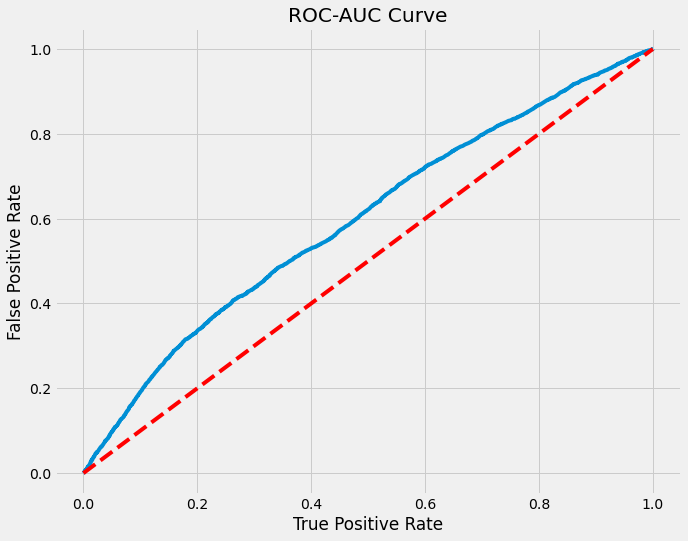

In [262]:
fpr, tpr, threshold = roc_curve(y_test, y_prob_test)

plt.plot(fpr,tpr)
plt.plot(fpr,fpr,'--r')
plt.title('ROC-AUC Curve')
plt.xlabel('True Positive Rate')
plt.ylabel('False Positive Rate')
plt.show()

In [263]:
X = df_new.drop('No-show',axis = 1)

y = df_new['No-show']

Xc = sm.add_constant(X)

In [264]:
model = sm.Logit(y,Xc).fit()

print(model.summary())

Optimization terminated successfully.
         Current function value: 0.443614
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:               110524
Model:                          Logit   Df Residuals:                   110504
Method:                           MLE   Df Model:                           19
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                  0.1182
Time:                        15:08:43   Log-Likelihood:                -49030.
converged:                       True   LL-Null:                       -55602.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -1.7848      0.028    -64.820      0.000      -1.839      -1.731

In [265]:
X_train, X_test, y_train, y_test = train_test_split(X, y, random_state = 10, test_size = 0.3)

logreg = LogisticRegression(solver = 'liblinear')
logreg = logreg.fit(X_train,y_train)

y_pred_train = logreg.predict(X_train)
y_prob_train = logreg.predict_proba(X_train)[:,1]

y_pred_test = logreg.predict(X_test)
y_prob_test = logreg.predict_proba(X_test)[:,1]

print('Confusion Matrix-Train','\n' ,confusion_matrix(y_train,y_pred_train),'\n')
print('Classification Report -Train','\n' ,classification_report(y_train,y_pred_train))
print('Accuracy-Train', '\n' ,accuracy_score(y_train,y_pred_train),'\n')
print('ROC_AUC-Train', '\n' ,roc_auc_score(y_train,y_prob_train),'\n')

print('Confusion Matrix-Test', '\n' ,confusion_matrix(y_test,y_pred_test),'\n')
print('Classification Report -Test','\n' ,classification_report(y_test,y_pred_test))
print('Accuracy-Test', '\n' ,accuracy_score(y_test,y_pred_test),'\n')
print('ROC_AUC-Test','\n' , roc_auc_score(y_test,y_prob_test),'\n')

Confusion Matrix-Train 
 [[60931   778]
 [13332  2325]] 

Classification Report -Train 
               precision    recall  f1-score   support

           0       0.82      0.99      0.90     61709
           1       0.75      0.15      0.25     15657

    accuracy                           0.82     77366
   macro avg       0.78      0.57      0.57     77366
weighted avg       0.81      0.82      0.77     77366

Accuracy-Train 
 0.8176201432153659 

ROC_AUC-Train 
 0.7405322031546175 

Confusion Matrix-Test 
 [[26165   331]
 [ 5635  1027]] 

Classification Report -Test 
               precision    recall  f1-score   support

           0       0.82      0.99      0.90     26496
           1       0.76      0.15      0.26      6662

    accuracy                           0.82     33158
   macro avg       0.79      0.57      0.58     33158
weighted avg       0.81      0.82      0.77     33158

Accuracy-Test 
 0.8200735870679776 

ROC_AUC-Test 
 0.7421795375648823 



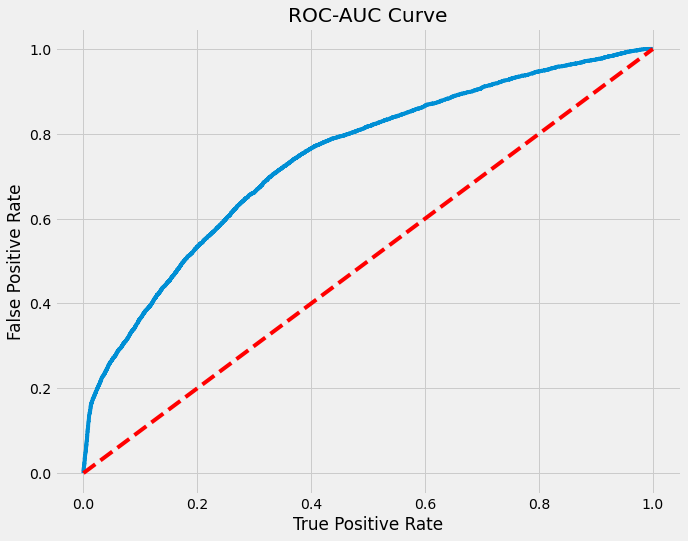

In [266]:
fpr, tpr, threshold = roc_curve(y_test, y_prob_test)

plt.plot(fpr,tpr)
plt.plot(fpr,fpr,'--r')
plt.title('ROC-AUC Curve')
plt.xlabel('True Positive Rate')
plt.ylabel('False Positive Rate')
plt.show()

In [267]:
X1 = df_new.drop(['No-show','Neighbourhood_Group6','Gender','Neighbourhood_Group2',
                  'Neighbourhood_Group5','Handcap','Neighbourhood_Group1','Hipertension'],axis = 1)

Xc1 = sm.add_constant(X1)

In [268]:
model = sm.Logit(y,Xc1).fit()

print(model.summary())

Optimization terminated successfully.
         Current function value: 0.443714
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:               110524
Model:                          Logit   Df Residuals:                   110511
Method:                           MLE   Df Model:                           12
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                  0.1180
Time:                        15:08:45   Log-Likelihood:                -49041.
converged:                       True   LL-Null:                       -55602.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -1.7506      0.020    -86.411      0.000      -1.790      -1.711

In [269]:
from sklearn.metrics import confusion_matrix,accuracy_score, f1_score, classification_report
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X1, y, random_state = 10, test_size = 0.3)

logreg = LogisticRegression(solver = 'liblinear')
logreg = logreg.fit(X_train,y_train)

y_pred_train = logreg.predict(X_train)
y_prob_train = logreg.predict_proba(X_train)[:,1]

y_pred_test = logreg.predict(X_test)
y_prob_test = logreg.predict_proba(X_test)[:,1]

print('Confusion Matrix-Train','\n' ,confusion_matrix(y_train,y_pred_train),'\n')
print('Classification Report -Train','\n' ,classification_report(y_train,y_pred_train))
print('Accuracy-Train', '\n' ,accuracy_score(y_train,y_pred_train),'\n')
print('ROC_AUC-Train', '\n' ,roc_auc_score(y_train,y_prob_train),'\n')

print('Confusion Matrix-Test', '\n' ,confusion_matrix(y_test,y_pred_test),'\n')
print('Classification Report -Test','\n' ,classification_report(y_test,y_pred_test))
print('Accuracy-Test', '\n' ,accuracy_score(y_test,y_pred_test),'\n')
print('ROC_AUC-Test','\n' , roc_auc_score(y_test,y_prob_test),'\n')

Confusion Matrix-Train 
 [[60946   763]
 [13359  2298]] 

Classification Report -Train 
               precision    recall  f1-score   support

           0       0.82      0.99      0.90     61709
           1       0.75      0.15      0.25     15657

    accuracy                           0.82     77366
   macro avg       0.79      0.57      0.57     77366
weighted avg       0.81      0.82      0.76     77366

Accuracy-Train 
 0.8174650363208644 

ROC_AUC-Train 
 0.7405659567759086 

Confusion Matrix-Test 
 [[26171   325]
 [ 5648  1014]] 

Classification Report -Test 
               precision    recall  f1-score   support

           0       0.82      0.99      0.90     26496
           1       0.76      0.15      0.25      6662

    accuracy                           0.82     33158
   macro avg       0.79      0.57      0.58     33158
weighted avg       0.81      0.82      0.77     33158

Accuracy-Test 
 0.8198624766270584 

ROC_AUC-Test 
 0.7421258371575683 



In [270]:
X_train, X_test, y_train, y_test = train_test_split(X1, y, random_state = 10, test_size = 0.3)

logreg = LogisticRegression(solver = 'liblinear')
logreg = logreg.fit(X_train,y_train)

y_pred_train = logreg.predict(X_train)
y_prob_train = logreg.predict_proba(X_train)[:,1]

y_pred_test = logreg.predict(X_test)
y_prob_test = logreg.predict_proba(X_test)[:,1]

print('Confusion Matrix-Train','\n' ,confusion_matrix(y_train,y_pred_train),'\n')
print('Classification Report -Train','\n' ,classification_report(y_train,y_pred_train))
print('F2 score Train: ', '\n', fbeta_score(y_train,y_pred_train, beta = 2), '\n')
print('ROC_AUC-Train', '\n' ,roc_auc_score(y_train,y_prob_train),'\n')

print('Confusion Matrix-Test','\n' ,confusion_matrix(y_test,y_pred_test),'\n')
print('Classification Report -Test','\n' ,classification_report(y_test,y_pred_test))
print('F2 score Test: ', '\n', fbeta_score(y_test,y_pred_test, beta = 2), '\n')
print('ROC_AUC-Test','\n' , roc_auc_score(y_test,y_prob_test),'\n')

Confusion Matrix-Train 
 [[60946   763]
 [13359  2298]] 

Classification Report -Train 
               precision    recall  f1-score   support

           0       0.82      0.99      0.90     61709
           1       0.75      0.15      0.25     15657

    accuracy                           0.82     77366
   macro avg       0.79      0.57      0.57     77366
weighted avg       0.81      0.82      0.76     77366

F2 score Train:  
 0.17491513038712722 

ROC_AUC-Train 
 0.7405659567759086 

Confusion Matrix-Test 
 [[26171   325]
 [ 5648  1014]] 

Classification Report -Test 
               precision    recall  f1-score   support

           0       0.82      0.99      0.90     26496
           1       0.76      0.15      0.25      6662

    accuracy                           0.82     33158
   macro avg       0.79      0.57      0.58     33158
weighted avg       0.81      0.82      0.77     33158

F2 score Test:  
 0.18115553649908883 

ROC_AUC-Test 
 0.7421258371575683 



In [271]:
# Does Oversampling increase our prediction auc score

Xy_train = pd.concat([X_train, y_train], axis = 1)

Xy_train0 = Xy_train[Xy_train['No-show'] == 0]
Xy_train1 = Xy_train[Xy_train['No-show'] == 1]

len0 = len(Xy_train0)
len1 = len(Xy_train1)

Xy_train1_os = Xy_train1.sample(len0,replace = True, random_state = 42)

Xy_train_os = pd.concat([Xy_train1_os, Xy_train0], axis = 0)

y_train_os = Xy_train_os['No-show']
X_train_os = Xy_train_os.drop(['No-show'], axis = 1)

print(y_train.value_counts(),'\n',y_train_os.value_counts())

0    61709
1    15657
Name: No-show, dtype: int64 
 1    61709
0    61709
Name: No-show, dtype: int64


In [272]:
logreg = LogisticRegression(solver = 'liblinear')
logreg = logreg.fit(X_train_os,y_train_os)

y_pred_train = logreg.predict(X_train_os)
y_prob_train = logreg.predict_proba(X_train_os)[:,1]

y_pred_test = logreg.predict(X_test)
y_prob_test = logreg.predict_proba(X_test)[:,1]

print('Confusion Matrix-Train','\n' ,confusion_matrix(y_train_os,y_pred_train),'\n')
print('Classification Report -Train','\n' ,classification_report(y_train_os,y_pred_train))
print('Accuracy-Train', '\n' ,accuracy_score(y_train_os,y_pred_train),'\n')
print('ROC_AUC-Train', '\n' ,roc_auc_score(y_train_os,y_prob_train),'\n')

print('Confusion Matrix-Test', '\n' ,confusion_matrix(y_test,y_pred_test),'\n')
print('Classification Report -Test','\n' ,classification_report(y_test,y_pred_test))
print('Accuracy-Test', '\n' ,accuracy_score(y_test,y_pred_test),'\n')
print('ROC_AUC-Test','\n' , roc_auc_score(y_test,y_prob_test),'\n')

Confusion Matrix-Train 
 [[46173 15536]
 [24558 37151]] 

Classification Report -Train 
               precision    recall  f1-score   support

           0       0.65      0.75      0.70     61709
           1       0.71      0.60      0.65     61709

    accuracy                           0.68    123418
   macro avg       0.68      0.68      0.67    123418
weighted avg       0.68      0.68      0.67    123418

Accuracy-Train 
 0.6751365278970652 

ROC_AUC-Train 
 0.7431944704266191 

Confusion Matrix-Test 
 [[19768  6728]
 [ 2619  4043]] 

Classification Report -Test 
               precision    recall  f1-score   support

           0       0.88      0.75      0.81     26496
           1       0.38      0.61      0.46      6662

    accuracy                           0.72     33158
   macro avg       0.63      0.68      0.64     33158
weighted avg       0.78      0.72      0.74     33158

Accuracy-Test 
 0.718107244103987 

ROC_AUC-Test 
 0.7445874051374005 



In [273]:
import imblearn
from imblearn.over_sampling import SMOTE

smote = SMOTE(sampling_strategy = 'minority')

X_train_sm, y_train_sm = smote.fit_resample(X_train, y_train)

print(y_train.value_counts(), '\n', y_train_sm.value_counts())

0    61709
1    15657
Name: No-show, dtype: int64 
 0    61709
1    61709
Name: No-show, dtype: int64


In [274]:
logreg = LogisticRegression(solver = 'liblinear')
logreg = logreg.fit(X_train_sm,y_train_sm)

y_pred_train = logreg.predict(X_train_sm)
y_prob_train = logreg.predict_proba(X_train_sm)[:,1]

y_pred_test = logreg.predict(X_test)
y_prob_test = logreg.predict_proba(X_test)[:,1]

print('Confusion Matrix-Train','\n' ,confusion_matrix(y_train_sm,y_pred_train),'\n')
print('Classification Report -Train','\n' ,classification_report(y_train_sm,y_pred_train))
print('Accuracy-Train', '\n' ,accuracy_score(y_train_sm,y_pred_train),'\n')
print('ROC_AUC-Train', '\n' ,roc_auc_score(y_train_sm,y_prob_train),'\n')

print('Confusion Matrix-Test', '\n' ,confusion_matrix(y_test,y_pred_test),'\n')
print('Classification Report -Test','\n' ,classification_report(y_test,y_pred_test))
print('Accuracy-Test', '\n' ,accuracy_score(y_test,y_pred_test),'\n')
print('ROC_AUC-Test','\n' , roc_auc_score(y_test,y_prob_test),'\n')

Confusion Matrix-Train 
 [[46321 15388]
 [22521 39188]] 

Classification Report -Train 
               precision    recall  f1-score   support

           0       0.67      0.75      0.71     61709
           1       0.72      0.64      0.67     61709

    accuracy                           0.69    123418
   macro avg       0.70      0.69      0.69    123418
weighted avg       0.70      0.69      0.69    123418

Accuracy-Train 
 0.6928405905135393 

ROC_AUC-Train 
 0.75632665833549 

Confusion Matrix-Test 
 [[19788  6708]
 [ 2721  3941]] 

Classification Report -Test 
               precision    recall  f1-score   support

           0       0.88      0.75      0.81     26496
           1       0.37      0.59      0.46      6662

    accuracy                           0.72     33158
   macro avg       0.62      0.67      0.63     33158
weighted avg       0.78      0.72      0.74     33158

Accuracy-Test 
 0.7156342360817902 

ROC_AUC-Test 
 0.7203899868721511 



In [275]:
from sklearn.metrics import confusion_matrix,accuracy_score, f1_score, classification_report
from sklearn.metrics import roc_curve, roc_auc_score
from sklearn.model_selection import cross_val_score, KFold

logreg = LogisticRegression()

kf = KFold(n_splits = 10, shuffle = True, random_state = 10)

score = cross_val_score(logreg, X, y, cv = kf, scoring = 'roc_auc')

print('ROC-AUC Score', np.mean(np.abs(score)))
print('Bias Error', np.mean(np.abs(1-score)))
print('Variance Error', np.std(np.abs(score),ddof = 1))

ROC-AUC Score 0.7405096842858594
Bias Error 0.2594903157141406
Variance Error 0.006460257451654803


## Logistic Model Improvement

In [223]:
X = df_new.drop(['No-show'],axis = 1)

y = df_new['No-show']

Xc = sm.add_constant(X)

X_train, X_test, y_train, y_test = train_test_split(Xc, y, random_state = 10, test_size = 0.3)

In [224]:
# build the model on train data (X_train and y_train)
# use fit() to fit the logistic regression model
logreg = sm.Logit(y_train, X_train).fit()

# print the summary of the model
print(logreg.summary())

Optimization terminated successfully.
         Current function value: 0.445424
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:                77366
Model:                          Logit   Df Residuals:                    77346
Method:                           MLE   Df Model:                           19
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                  0.1157
Time:                        14:59:25   Log-Likelihood:                -34461.
converged:                       True   LL-Null:                       -38968.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                   -1.7801      0.033    -54.229      0.000      -1.844      -1.716

In [225]:
# let 'y_pred_prob' be the predicted values of y
y_pred_prob = logreg.predict(X_test)

# print the y_pred_prob
y_pred_prob.head()

16415    0.167799
23132    0.285446
71910    0.150561
105620   0.182518
2681     0.152274
dtype: float64

In [226]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)

youdens_table = pd.DataFrame({'TPR': tpr,
                             'FPR': fpr,
                             'Threshold': thresholds})

youdens_table['Difference'] = youdens_table.TPR - youdens_table.FPR

youdens_table = youdens_table.sort_values('Difference', ascending = False).reset_index(drop = True)

youdens_table.head()

,TPR,FPR,Threshold,Difference
0,0.705194,0.333522,0.172738,0.371672
1,0.705194,0.333560,0.172735,0.371634
2,0.705494,0.333899,0.172636,0.371594
3,0.705194,0.333635,0.172732,0.371558
4,0.705644,0.334088,0.172573,0.371556


In [227]:
y_pred_youden = [ 0 if x < 0.172738 else 1 for x in y_pred_prob]

In [228]:
# calculate various performance measures
print(classification_report(y_test, y_pred_youden), '\n')

print('F2 score: ',fbeta_score(y_test,y_pred_youden, beta = 2), '\n')

print('AUC ROC Score: ',roc_auc_score(y_test, y_pred_prob))

              precision    recall  f1-score   support

           0       0.90      0.67      0.77     26496
           1       0.35      0.71      0.47      6662

    accuracy                           0.67     33158
   macro avg       0.62      0.69      0.62     33158
weighted avg       0.79      0.67      0.71     33158
 

F2 score:  0.584465681150764 

AUC ROC Score:  0.7421838091238142


### CLASS IMBALANCE TECHNIQUES

# SMOTE

In [229]:
import imblearn
from imblearn.over_sampling import SMOTE
from collections import Counter
counter=Counter(y_train)
print('Before' , counter)
smt=SMOTE(random_state=10)

X_train_sm, y_train_sm = smt.fit_resample(X_train, y_train)
counter=Counter(y_train_sm)
print('After',counter)

Before Counter({0: 61709, 1: 15657})
After Counter({0: 61709, 1: 61709})


In [230]:
# build the model on train data (X_train and y_train)
# use fit() to fit the logistic regression model
logreg_sm = sm.Logit(y_train_sm, X_train_sm).fit()

# print the summary of the model
print(logreg_sm.summary())

Optimization terminated successfully.
         Current function value: 0.555978
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:               123418
Model:                          Logit   Df Residuals:                   123398
Method:                           MLE   Df Model:                           19
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                  0.1979
Time:                        14:59:29   Log-Likelihood:                -68618.
converged:                       True   LL-Null:                       -85547.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.7663      0.020     38.260      0.000       0.727       0.806

In [231]:
# let 'y_pred_prob' be the predicted values of y
y_pred_prob = logreg_sm.predict(X_test)

# print the y_pred_prob
y_pred_prob.head()

16415    0.376074
23132    0.816832
71910    0.226521
105620   0.455210
2681     0.294306
dtype: float64

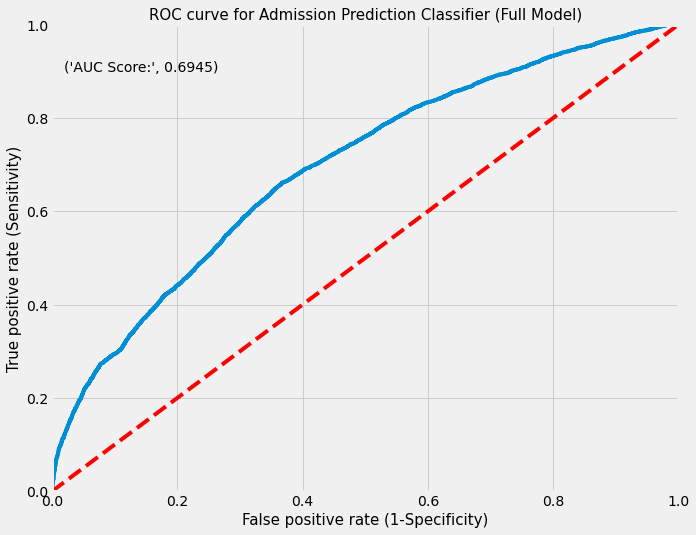

In [232]:
from sklearn import metrics
# the roc_curve() returns the values for false positive rate, true positive rate and threshold
# pass the actual target values and predicted probabilities to the function
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
# plot the ROC curve
plt.plot(fpr, tpr)

# set limits for x and y axes
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])

# plot the straight line showing worst prediction for the model
plt.plot([0, 1], [0, 1],'r--')

# add plot and axes labels
# set text size using 'fontsize'
plt.title('ROC curve for Admission Prediction Classifier (Full Model)', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)

# add the AUC score to the plot
# 'x' and 'y' gives position of the text
# 's' is the text 
# use round() to round-off the AUC score upto 4 digits
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test, y_pred_prob),4)))
                               
# plot the grid
plt.grid(True)

In [233]:
youdens_table = pd.DataFrame({'TPR': tpr,
                             'FPR': fpr,
                             'Threshold': thresholds})

# calculate the difference between TPR and FPR for each threshold and store the values in a new column 'Difference'
youdens_table['Difference'] = youdens_table.TPR - youdens_table.FPR

# sort the dataframe based on the values of difference 
# 'ascending = False' sorts the data in descending order
# 'reset_index' resets the index of the dataframe
# 'drop = True' drops the previous index
youdens_table = youdens_table.sort_values('Difference', ascending = False).reset_index(drop = True)

# print the first five observations
youdens_table.head()

,TPR,FPR,Threshold,Difference
0,0.661513,0.367188,0.397937,0.294326
1,0.661513,0.367225,0.397864,0.294288
2,0.661363,0.367150,0.397977,0.294213
3,0.661363,0.367188,0.397948,0.294175
4,0.661213,0.367112,0.398038,0.294101


In [234]:
y_pred_youden = [ 0 if x < 0.397937 else 1 for x in y_pred_prob]

In [235]:
# calculate various performance measures
print(classification_report(y_test, y_pred_youden), '\n')

print('F2 score: ',fbeta_score(y_test,y_pred_youden, beta = 2), '\n')

print('AUC ROC Score: ',roc_auc_score(y_test, y_pred_prob))

              precision    recall  f1-score   support

           0       0.88      0.63      0.74     26496
           1       0.31      0.66      0.42      6662

    accuracy                           0.64     33158
   macro avg       0.60      0.65      0.58     33158
weighted avg       0.77      0.64      0.67     33158
 

F2 score:  0.5402854060415848 

AUC ROC Score:  0.6945145880875672


# SMOTE ENN

In [236]:
import imblearn
from imblearn.combine import SMOTEENN
from collections import Counter
counter=Counter(y_train)
print('Before' , counter)
senn=SMOTEENN(random_state=10)

X_train_senn, y_train_senn = senn.fit_resample(X_train, y_train)
counter=Counter(y_train_senn)
print('After',counter)

Before Counter({0: 61709, 1: 15657})
After Counter({1: 45276, 0: 33216})


In [237]:
# build the model on train data (X_train and y_train)
# use fit() to fit the logistic regression model
logreg_senn = sm.Logit(y_train_senn, X_train_senn).fit()

# print the summary of the model
print(logreg_senn.summary())

Optimization terminated successfully.
         Current function value: 0.415256
         Iterations 8
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:                78492
Model:                          Logit   Df Residuals:                    78472
Method:                           MLE   Df Model:                           19
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                  0.3905
Time:                        15:02:51   Log-Likelihood:                -32594.
converged:                       True   LL-Null:                       -53476.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.5814      0.029     19.927      0.000       0.524       0.639

In [238]:
# let 'y_pred_prob' be the predicted values of y
y_pred_prob = logreg_senn.predict(X_test)

# print the y_pred_prob
y_pred_prob.head()

16415    0.407553
23132    0.953103
71910    0.283093
105620   0.506707
2681     0.220127
dtype: float64

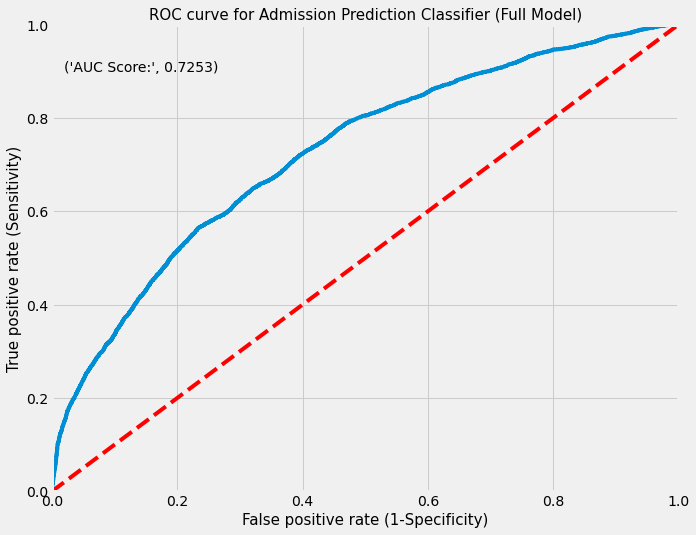

In [239]:
from sklearn import metrics
# the roc_curve() returns the values for false positive rate, true positive rate and threshold
# pass the actual target values and predicted probabilities to the function
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
# plot the ROC curve
plt.plot(fpr, tpr)

# set limits for x and y axes
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])

# plot the straight line showing worst prediction for the model
plt.plot([0, 1], [0, 1],'r--')

# add plot and axes labels
# set text size using 'fontsize'
plt.title('ROC curve for Admission Prediction Classifier (Full Model)', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)

# add the AUC score to the plot
# 'x' and 'y' gives position of the text
# 's' is the text 
# use round() to round-off the AUC score upto 4 digits
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test, y_pred_prob),4)))
                               
# plot the grid
plt.grid(True)

In [240]:
youdens_table = pd.DataFrame({'TPR': tpr,
                             'FPR': fpr,
                             'Threshold': thresholds})

# calculate the difference between TPR and FPR for each threshold and store the values in a new column 'Difference'
youdens_table['Difference'] = youdens_table.TPR - youdens_table.FPR

# sort the dataframe based on the values of difference 
# 'ascending = False' sorts the data in descending order
# 'reset_index' resets the index of the dataframe
# 'drop = True' drops the previous index
youdens_table = youdens_table.sort_values('Difference', ascending = False).reset_index(drop = True)

# print the first five observations
youdens_table.head()

,TPR,FPR,Threshold,Difference
0,0.566046,0.235205,0.643710,0.330841
1,0.564245,0.233469,0.646441,0.330776
2,0.564845,0.234073,0.645271,0.330772
3,0.565896,0.235130,0.643733,0.330766
4,0.564395,0.233658,0.645855,0.330737


In [241]:
y_pred_youden = [ 0 if x < 0.643710 else 1 for x in y_pred_prob]

In [242]:
# calculate various performance measures
print(classification_report(y_test, y_pred_youden), '\n')

print('F2 score: ',fbeta_score(y_test,y_pred_youden, beta = 2), '\n')

print('AUC ROC Score: ',roc_auc_score(y_test, y_pred_prob))

              precision    recall  f1-score   support

           0       0.88      0.76      0.82     26496
           1       0.38      0.57      0.45      6662

    accuracy                           0.72     33158
   macro avg       0.63      0.67      0.63     33158
weighted avg       0.78      0.72      0.74     33158
 

F2 score:  0.5143387268411143 

AUC ROC Score:  0.7252969770188771


# ADASYN

In [243]:
import imblearn
from imblearn.over_sampling import ADASYN
from collections import Counter
counter=Counter(y_train)
print('Before' , counter)
ada=ADASYN(random_state=10)

X_train_ada, y_train_ada = ada.fit_resample(X_train, y_train)
counter=Counter(y_train_ada)
print('After',counter)

Before Counter({0: 61709, 1: 15657})
After Counter({0: 61709, 1: 60753})


In [244]:
# build the model on train data (X_train and y_train)
# use fit() to fit the logistic regression model
logreg_ada = sm.Logit(y_train_ada, X_train_ada).fit()

# print the summary of the model
print(logreg_ada.summary())

Optimization terminated successfully.
         Current function value: 0.567164
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:               122462
Model:                          Logit   Df Residuals:                   122442
Method:                           MLE   Df Model:                           19
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                  0.1817
Time:                        15:03:10   Log-Likelihood:                -69456.
converged:                       True   LL-Null:                       -84880.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.8235      0.020     41.306      0.000       0.784       0.863

In [245]:
# let 'y_pred_prob' be the predicted values of y
y_pred_prob = logreg_ada.predict(X_test)

# print the y_pred_prob
y_pred_prob.head()

16415    0.377399
23132    0.820096
71910    0.228838
105620   0.468939
2681     0.295434
dtype: float64

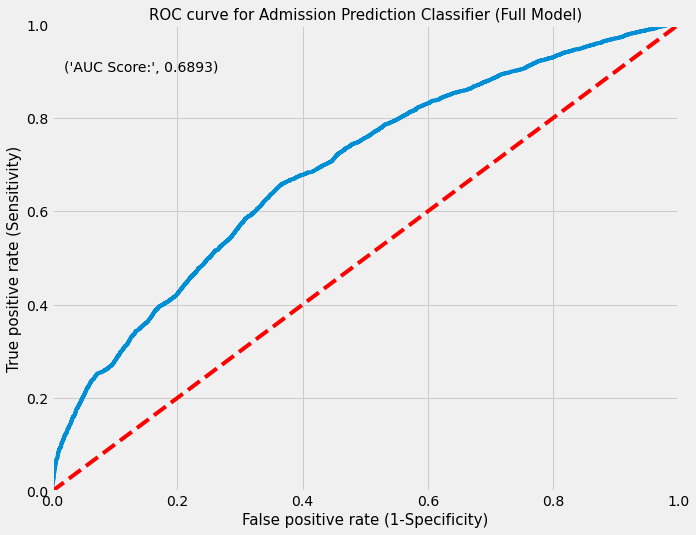

In [246]:
from sklearn import metrics
# the roc_curve() returns the values for false positive rate, true positive rate and threshold
# pass the actual target values and predicted probabilities to the function
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
# plot the ROC curve
plt.plot(fpr, tpr)

# set limits for x and y axes
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])

# plot the straight line showing worst prediction for the model
plt.plot([0, 1], [0, 1],'r--')

# add plot and axes labels
# set text size using 'fontsize'
plt.title('ROC curve for Admission Prediction Classifier (Full Model)', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)

# add the AUC score to the plot
# 'x' and 'y' gives position of the text
# 's' is the text 
# use round() to round-off the AUC score upto 4 digits
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test, y_pred_prob),4)))
                               
# plot the grid
plt.grid(True)

In [247]:
youdens_table = pd.DataFrame({'TPR': tpr,
                             'FPR': fpr,
                             'Threshold': thresholds})

# calculate the difference between TPR and FPR for each threshold and store the values in a new column 'Difference'
youdens_table['Difference'] = youdens_table.TPR - youdens_table.FPR

# sort the dataframe based on the values of difference 
# 'ascending = False' sorts the data in descending order
# 'reset_index' resets the index of the dataframe
# 'drop = True' drops the previous index
youdens_table = youdens_table.sort_values('Difference', ascending = False).reset_index(drop = True)

# print the first five observations
youdens_table.head()

,TPR,FPR,Threshold,Difference
0,0.659562,0.367829,0.401950,0.291733
1,0.659712,0.368018,0.401821,0.291694
2,0.659862,0.368207,0.401675,0.291655
3,0.660012,0.368357,0.401607,0.291655
4,0.659412,0.367791,0.401999,0.291620


In [248]:
y_pred_youden = [ 0 if x < 0.401950 else 1 for x in y_pred_prob]

In [249]:
# calculate various performance measures
print(classification_report(y_test, y_pred_youden), '\n')

print('F2 score: ',fbeta_score(y_test,y_pred_youden, beta = 2), '\n')

print('AUC ROC Score: ',roc_auc_score(y_test, y_pred_prob))

              precision    recall  f1-score   support

           0       0.88      0.63      0.74     26496
           1       0.31      0.66      0.42      6662

    accuracy                           0.64     33158
   macro avg       0.60      0.65      0.58     33158
weighted avg       0.77      0.64      0.67     33158
 

F2 score:  0.5386388153378444 

AUC ROC Score:  0.6892656182924062


# SMOTE + ENN

In [250]:
import imblearn
from imblearn.combine import SMOTEENN
from collections import Counter
from imblearn.under_sampling import EditedNearestNeighbours
counter=Counter(y_train)
print('Before' , counter)
smote=SMOTE(random_state=10)
enn=EditedNearestNeighbours()
se=SMOTEENN(random_state=10,smote=smote,enn=enn)
X_train_se, y_train_se = se.fit_resample(X_train, y_train)
counter=Counter(y_train_se)
print('After',counter)

Before Counter({0: 61709, 1: 15657})
After Counter({0: 61709, 1: 45276})


In [251]:
# build the model on train data (X_train and y_train)
# use fit() to fit the logistic regression model
logreg_se = sm.Logit(y_train_se, X_train_se).fit()

# print the summary of the model
print(logreg_se.summary())

Optimization terminated successfully.
         Current function value: 0.507682
         Iterations 7
                           Logit Regression Results                           
Dep. Variable:                No-show   No. Observations:               106985
Model:                          Logit   Df Residuals:                   106965
Method:                           MLE   Df Model:                           19
Date:                Sat, 16 Jul 2022   Pseudo R-squ.:                  0.2548
Time:                        15:04:49   Log-Likelihood:                -54314.
converged:                       True   LL-Null:                       -72889.
Covariance Type:            nonrobust   LLR p-value:                     0.000
                           coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------
const                    0.2367      0.022     10.556      0.000       0.193       0.281

In [252]:
# let 'y_pred_prob' be the predicted values of y
y_pred_prob = logreg_se.predict(X_test)

# print the y_pred_prob
y_pred_prob.head()

16415    0.280329
23132    0.812029
71910    0.149786
105620   0.305310
2681     0.187951
dtype: float64

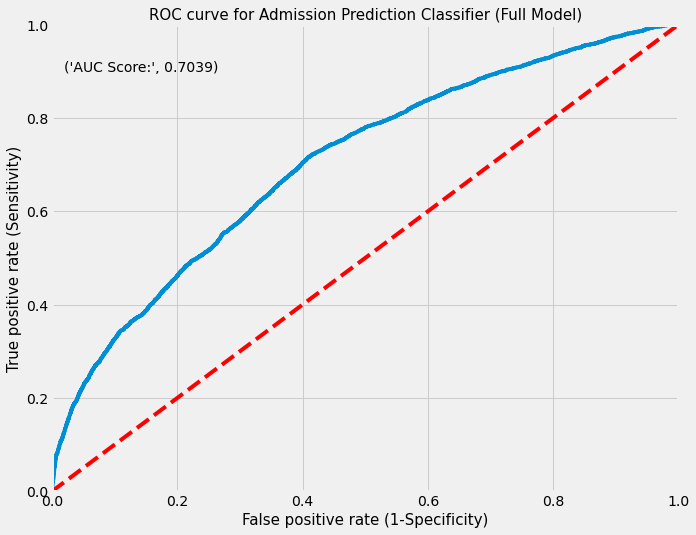

In [253]:
from sklearn import metrics
# the roc_curve() returns the values for false positive rate, true positive rate and threshold
# pass the actual target values and predicted probabilities to the function
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)
# plot the ROC curve
plt.plot(fpr, tpr)

# set limits for x and y axes
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])

# plot the straight line showing worst prediction for the model
plt.plot([0, 1], [0, 1],'r--')

# add plot and axes labels
# set text size using 'fontsize'
plt.title('ROC curve for Admission Prediction Classifier (Full Model)', fontsize = 15)
plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)

# add the AUC score to the plot
# 'x' and 'y' gives position of the text
# 's' is the text 
# use round() to round-off the AUC score upto 4 digits
plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test, y_pred_prob),4)))
                               
# plot the grid
plt.grid(True)

In [254]:
youdens_table = pd.DataFrame({'TPR': tpr,
                             'FPR': fpr,
                             'Threshold': thresholds})

# calculate the difference between TPR and FPR for each threshold and store the values in a new column 'Difference'
youdens_table['Difference'] = youdens_table.TPR - youdens_table.FPR

# sort the dataframe based on the values of difference 
# 'ascending = False' sorts the data in descending order
# 'reset_index' resets the index of the dataframe
# 'drop = True' drops the previous index
youdens_table = youdens_table.sort_values('Difference', ascending = False).reset_index(drop = True)

# print the first five observations
youdens_table.head()

,TPR,FPR,Threshold,Difference
0,0.715551,0.408665,0.263538,0.306885
1,0.715551,0.408741,0.263515,0.306810
2,0.715101,0.408326,0.263847,0.306775
3,0.715251,0.408514,0.263660,0.306736
4,0.714950,0.408250,0.263957,0.306700


In [255]:
y_pred_youden = [ 0 if x < 0.263538 else 1 for x in y_pred_prob]

In [256]:
# calculate various performance measures
print(classification_report(y_test, y_pred_youden), '\n')

print('F2 score: ',fbeta_score(y_test,y_pred_youden, beta = 2), '\n')

print('AUC ROC Score: ',roc_auc_score(y_test, y_pred_prob))

              precision    recall  f1-score   support

           0       0.89      0.59      0.71     26496
           1       0.31      0.72      0.43      6662

    accuracy                           0.62     33158
   macro avg       0.60      0.65      0.57     33158
weighted avg       0.77      0.62      0.65     33158
 

F2 score:  0.5642354946381648 

AUC ROC Score:  0.703906947385815
